# 0 load all datasets as an adata

In [ ]:
###v3 adult atlas
cd /nfs/team298/ls34/disease_atlas/mrvi/
rm 0_load_all_data2.bsub.out
rm 0_load_all_data2.bsub.err
bsub -G team298 -q normal -n4 -M 400000 -o ./0_load_all_data3.bsub.out -e ./0_load_all_data3.bsub.err -R"select[mem>400000] rusage[mem=400000]" bash /nfs/users/nfs_l/ls34/fibroblast_atlas/0_load_all_data2.sh

## max was 311_000 but might add more data

In [ ]:
### outputs '/nfs/team298/ls34/disease_atlas/data/all_raw_addedcore_filteredmidqc.h5ad'

In [1]:
import scanpy as sc
adata = sc.read_h5ad('/nfs/team298/ls34/disease_atlas/data/all_raw_addedcore_filteredmidqc.h5ad')
adata

AnnData object with n_obs × n_vars = 2886061 × 36601
    obs: 'sample_id', 'barcode', 'dataset_id', 'GSE', 'Site_status', 'Patient_status', 'Location', 'Age', 'Sex', 'n_genes', 'OriginalAnnotation', 'Chemistry', 'lvl3_annotation', 'lvl2_annotation', 'lvl0_annotation', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'QC_hi', 'QC_mid'
    var: 'ensg_id', 'mt', 'ribo', 'hb', 'cc_fetal', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

# scvi integration

In [ ]:
run_scvi_fbs.py

In [ ]:
# ### first run (had error in code so did 3000 genes)
# cd /nfs/team298/ls34/disease_atlas/mrvi/
# rm ./1_scvi4_all2.bsub.err
# rm ./1_scvi4_all2.bsub.out
 
# bsub -G team298 -q gpu-normal -n4 -M 160000 -gpu "mode=exclusive_process:num=4"  -o ./1_scvi4_all3.bsub.out -e ./1_scvi4_all3.bsub.err -R"select[mem>320000] rusage[mem=320000]"  bash /nfs/users/nfs_l/ls34/fibroblast_atlas/1_scvi4_all.sh

# ### second run 
# cd /nfs/team298/ls34/disease_atlas/mrvi/
# rm ./1_scvi4_all2.bsub.err
# rm ./1_scvi4_all2.bsub.out
 
# bsub -G team298 -q gpu-huge-n2 -M 400000 -gpu "mode=exclusive_process:num=2"  -o ./1_scvi4_all2.bsub.out -e ./1_scvi4_all2.bsub.err -R"select[mem>400000] rusage[mem=400000]"  bash /nfs/users/nfs_l/ls34/fibroblast_atlas/1_scvi4_all.sh




# Look at scvi4 output (lesional + nonlesional, scvi integration)

In [1]:
import scanpy as sc
import os
import numpy as np
base_dir='/nfs/team298/ls34/disease_atlas/mrvi/'
[x for x in os.listdir(base_dir) if x.startswith('scvi4_all_SCVI')]

['scvi4_all_SCVIversion_6030_new2_clusterd']

In [2]:
base_dir_model='/nfs/team298/ls34/disease_atlas/mrvi/scvi4_all_SCVIversion_6030_new2_clusterd/'
[x for x in os.listdir(base_dir_model)] #if x.startswith('scvi4_all_SCVI')]

['adata.h5ad', 'model.pt']

In [3]:
adata_filename = 'adata_mrvi_all_scvi4_v2.h5ad'
adata=sc.read_h5ad(base_dir + adata_filename)
#adata=adata[adata.obs["dataset_id"] != "Atopic dermatitis_He"]


In [4]:
adata = adata[adata.obs["leiden_res0.2"]!="9"]
adata.shape



(2797943, 36601)

In [3]:
adata.obs.dataset_id.nunique()


44

In [ ]:
adata.obs.dataset_id.value_counts()

In [5]:
adata_filename = 'adata_scvi4_removedjunk.h5ad'
adata.write(base_dir + adata_filename)


In [2]:
import scanpy as sc
import os
import numpy as np
base_dir='/nfs/team298/ls34/disease_atlas/mrvi/'
[x for x in os.listdir(base_dir) if x.startswith('scvi4_all_SCVI')]
adata_filename = 'adata_scvi4_removedjunk.h5ad'
adata=sc.read_h5ad(base_dir + adata_filename)


In [9]:
adata_filename = 'adata_scvi4_removedjunk.h5ad'
adata.write(base_dir + adata_filename, 
           compression="gzip")


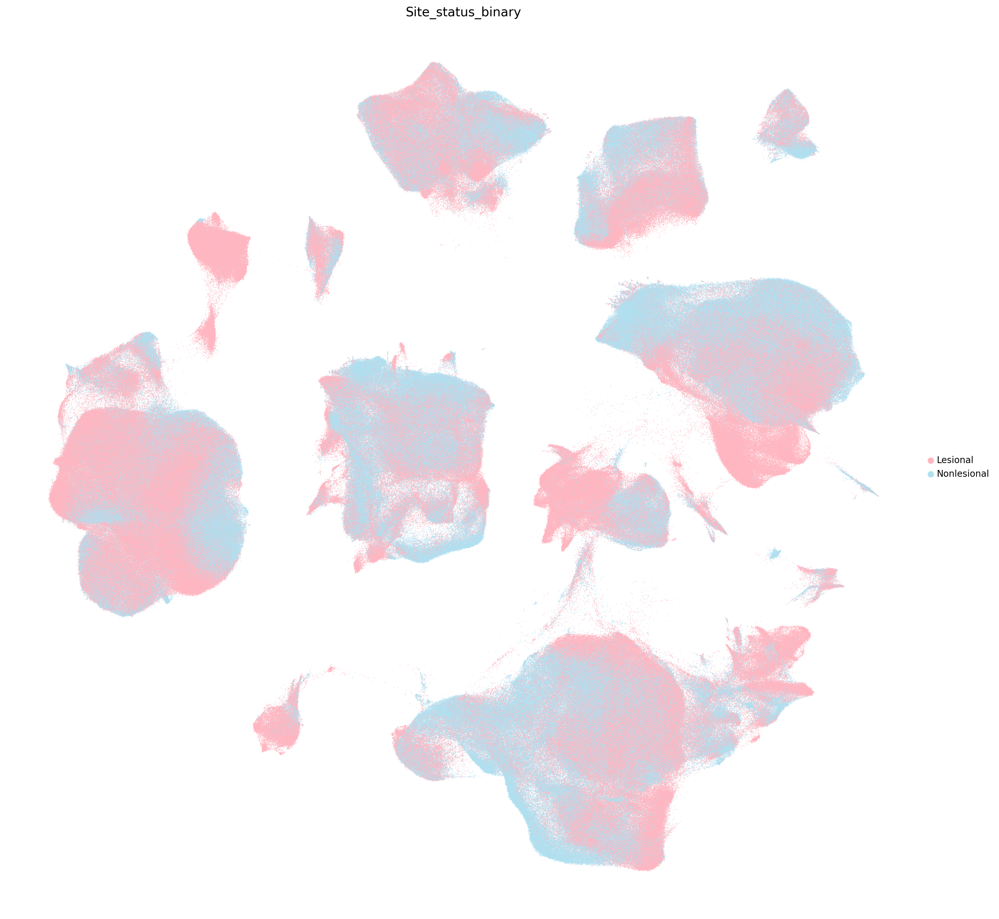

In [16]:
# Define custom colors
custom_colors = {
    "Nonlesional": "#b0e0f0",  # Light blue
    "Lesional":  "#FFB6C1",   #FFB6C1",  # Light red
  #  "Other": "#D3D3D3"  # Light grey
}

# Ensure 'fb_vs_other2' is a categorical column
adata.obs["Site_status_binary"] = adata.obs["Site_status_binary"].astype("category")

# Map colors to the categories in 'fb_vs_other2'
adata.uns['Site_status_binary_colors'] = [custom_colors[category] for category in adata.obs['Site_status_binary'].cat.categories]


sc.settings.set_figure_params(dpi=100, facecolor="white", frameon=False, figsize=(18,18))
sc.pl.umap(adata,  
       color = ["Site_status_binary"],
      s=2, vmax=5, vmin=-10,
      #legend_loc="on data",
      legend_fontsize=10)

# scvi5 (=like scvi4 but junk removed

In [6]:
### second run 
cd /nfs/team298/ls34/disease_atlas/mrvi/
rm ./1_scvi5_all.bsub.err
rm ./1_scvi5_all.bsub.out
 
bsub -G team298 -q gpu-normal -n2 -M 400000 -gpu "mode=exclusive_process:num=2"  -o ./1_scvi5_all.bsub.out -e ./1_scvi5_all.bsub.err -R"select[mem>400000] rusage[mem=400000]"  bash /nfs/users/nfs_l/ls34/fibroblast_atlas/1_scvi5_all.sh



(2797943, 36601)

In [ ]:
"""
saves here

"""

In [1]:
import scanpy as sc
import os
import numpy as np
base_dir='/nfs/team298/ls34/disease_atlas/mrvi/'
#[x for x in os.listdir(base_dir) if x.startswith('scvi4_all_SCVI')]
adata_filename = 'adata_all_scvi5.h5ad'
adata=sc.read_h5ad(base_dir + adata_filename)
adata


AnnData object with n_obs × n_vars = 2797943 × 36601
    obs: 'sample_id', 'barcode', 'dataset_id', 'GSE', 'Site_status', 'Patient_status', 'Location', 'Age', 'Sex', 'n_genes', 'OriginalAnnotation', 'Chemistry', 'lvl3_annotation', 'lvl2_annotation', 'lvl0_annotation', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'QC_hi', 'QC_mid', 'leiden_res0.2', 'Site_status_binary', 'atlas_status_reynolds', 'atlas_status', 'Site_status2', 'Patient_status2', 'Sex_original'
    var: 'ensg_id', 'mt', 'ribo', 'hb', 'cc_fetal', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable_nbatches', 'highly_variable'
    uns: 'leiden_res0.2', 'neighbor_30', 'umap'
    obsm: 'X_scvi', 'X_umap'
    obsp: 'neighbor_30_connectivities', 'neighbor_30_distances'

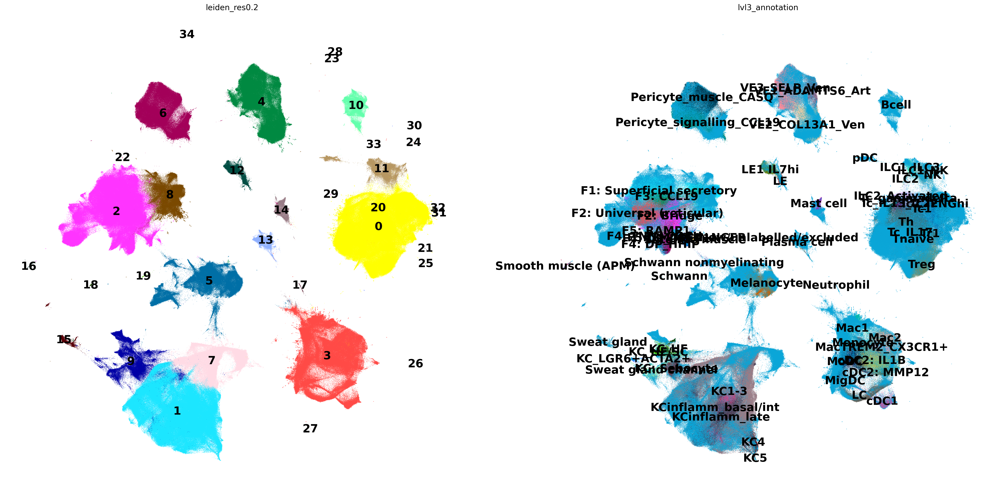

In [6]:
sc.settings.set_figure_params(dpi=100, facecolor="white", frameon=False, figsize=(15, 15))

sc.pl.umap(adata,  
           color=["leiden_res0.2", "lvl3_annotation"],
           s=1,
           legend_loc="on data",
           legend_fontsize=20)

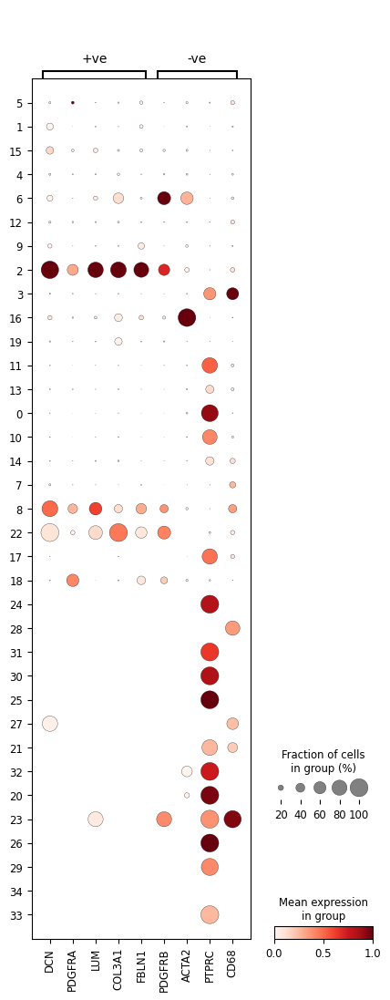

In [5]:
FB_MARKERS = {"+ve": ["DCN", "PDGFRA", "LUM", "COL3A1", "FBLN1"],
              "-ve": ["PDGFRB", "PTPRC", "CD68"]}
sc.pl.dotplot(
    adata,
    FB_MARKERS,
    groupby="leiden_res0.2",
   standard_scale="var",
    dendrogram=False)

In [9]:
adata=adata[adata.obs["leiden_res0.2"].isin(["2","8","22"])]
adata.shape

(238670, 36601)

In [8]:
adata=adata[adata.obs["Site_status_binary"]=="Lesional"]
adata.shape

(1640905, 36601)

In [12]:
adata.obs.dataset_id.value_counts()

Fascia1                   34762
Huda                      26955
Keloid_Direder            25634
SSc_Ma                    22086
Reynolds                  21786
Luc_psoriasis             21391
Prurigo_Patel             11593
Keloid_Deng                8712
Neurofibroma_Brousseau     6702
Dupuytren's_Dobie          6651
Lyme_jiang                 6026
AA_Greenleaf               5499
SSc_Tabib                  5450
Keloid_Shim                4938
Ma_psoriasis               4562
Ganier                     3452
ImmunotherapyReaction      3030
Nail_Kim                   2522
Sarcoidosis_Damsky         2212
Acne_Do                    2070
Lupus_Dunlap               1837
PSMorphoea                 1657
Boothby_Th2Stroma          1655
bcc_scc_yost               1332
HS_Gudjonsson              1059
AcralMM_Zhang               998
SCCarcinoma_Ji              924
AcralMM_Li                  770
bcc_yerly                   756
DRESS                       688
GA_Wang                     385
HS_Mario

In [14]:
adata = adata[~adata.obs["dataset_id"].isin(["Psoriasis_Kim2",
                                           "Psoriasis_Kim0",
                                            "Nail_Kim"
                                           ])]
adata.shape

(235968, 36601)

In [16]:
adata.obs["corefb_names"]="Lesional"
adata.obs["corefb_names_simple"]="Lesional"
adata.obs["test_ordered3"]="Lesional"
adata.obs["test_ordered4"]="Lesional"

/tmp/ipykernel_2289551/1152051224.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["corefb_names"]="Lesional"


In [17]:
base_dir='/nfs/team298/ls34/disease_atlas/mrvi/'
adata_filename = 'adata_scvi5_lesionalfbsonly.h5ad'
adata.write(base_dir+adata_filename)

In [18]:
base_dir+adata_filename

'/nfs/team298/ls34/disease_atlas/mrvi/adata_scvi5_lesionalfbsonly.h5ad'

In [1]:
import scanpy as sc
adata=sc.read_h5ad('/nfs/team298/ls34/disease_atlas/mrvi/adata_scvi5_lesionalfbsonly.h5ad'
                  )

In [2]:
adata.shape

(235968, 36601)

In [4]:
adata.obs["DonorID"]=adata.obs["sample_id"]

In [5]:
# Calculate the value counts of DonorID
donor_counts = adata.obs['DonorID'].value_counts()

# Identify DonorID values that occur at least 50 times
valid_donors = donor_counts[donor_counts >= 50].index

# Filter adata to keep only the valid DonorID entries
adata = adata[adata.obs['DonorID'].isin(valid_donors)].copy()

# Remove categories with less than 50 occurrences from the DonorID column
adata.obs['DonorID'] = adata.obs['DonorID'].cat.remove_categories(
    [donor for donor in adata.obs['DonorID'].cat.categories if donor not in valid_donors]
)

adata.shape

(235091, 36601)

##### import scanpy as sc
adata.write('/nfs/team298/ls34/disease_atlas/mrvi/adata_scvi5_lesionalfbsonly.h5ad'
                  )

In [ ]:
"""
go to jhub -. /fibroblast_atlas/1_fig1_ALLCELLS.ipynb to combine with nonlesional
"""

NameError: name 'adata' is not defined

In [ ]:
STOP

# Plot fig 1

In [ ]:
import scanpy as sc
import os
import numpy as np
base_dir='/nfs/team298/ls34/disease_atlas/mrvi/'
[x for x in os.listdir(base_dir) if x.startswith('scvi4_all_SCVI')]
adata_filename = 'adata_scvi4_removedjunk.h5ad'
adata=sc.read_h5ad(base_dir + adata_filename)


In [7]:
adata.obas["fb_vs_other"]=["Fibroblast" if x == "0" else "Other" for x in adata.obs["leiden_res0.2"]]
adata.obs["fb_vs_other"].value_counts()

Other         1645622
Fibroblast     379152
Name: fb_vs_other, dtype: int64

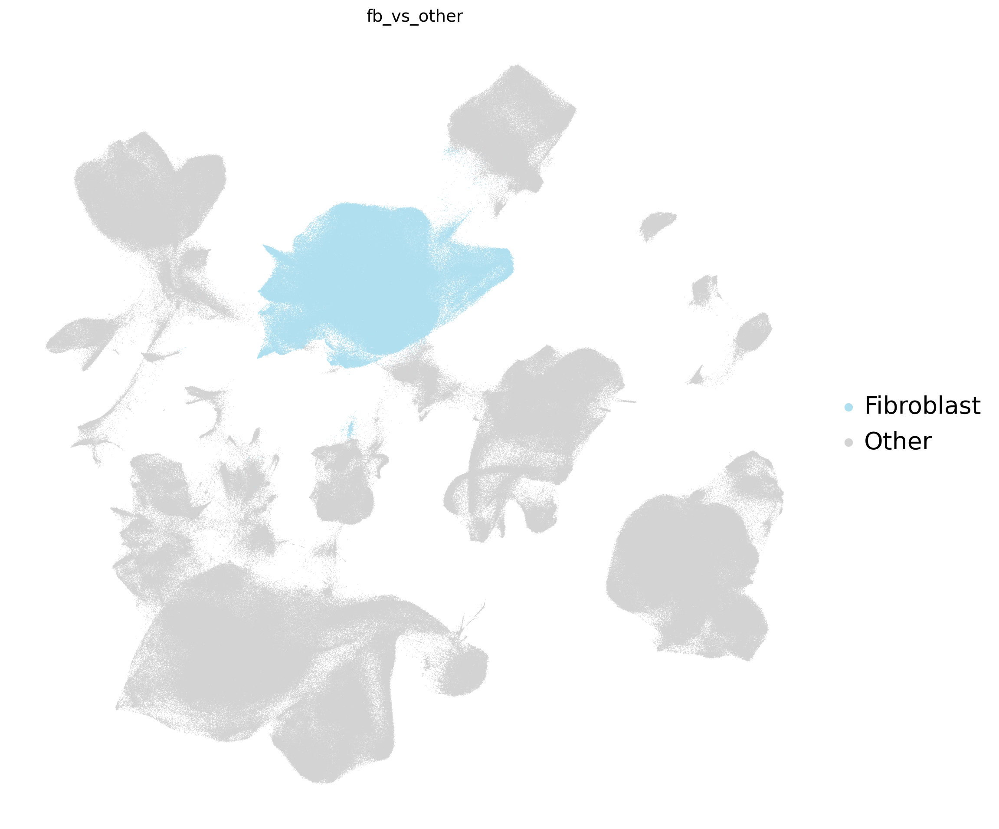

In [8]:
custom_colors = {
    "Fibroblast": "#b0e0f0", #"#36acca",  # Light blue
    "Other": "#D3D3D3"        # Light grey
}
adata.obs["fb_vs_other"] = adata.obs["fb_vs_other"].astype("category")
adata.uns['fb_vs_other_colors'] = [custom_colors[category] for category in adata.obs['fb_vs_other'].cat.categories]

# color_map = {
#     "Control_eczema": 
#     "Control_psoriasis": "#36acca",
#     "Eczema": "#fad09f",
#     "Psoriasis": "#f33033",
#     "Atlas": 
# }

sc.settings.set_figure_params(dpi=100, facecolor="white", frameon=False, figsize=(12,12))
# Plotting
sc.pl.umap(adata,  
           color="fb_vs_other",
           s=1,
           #legend_loc="on data",
           legend_fontsize=20)

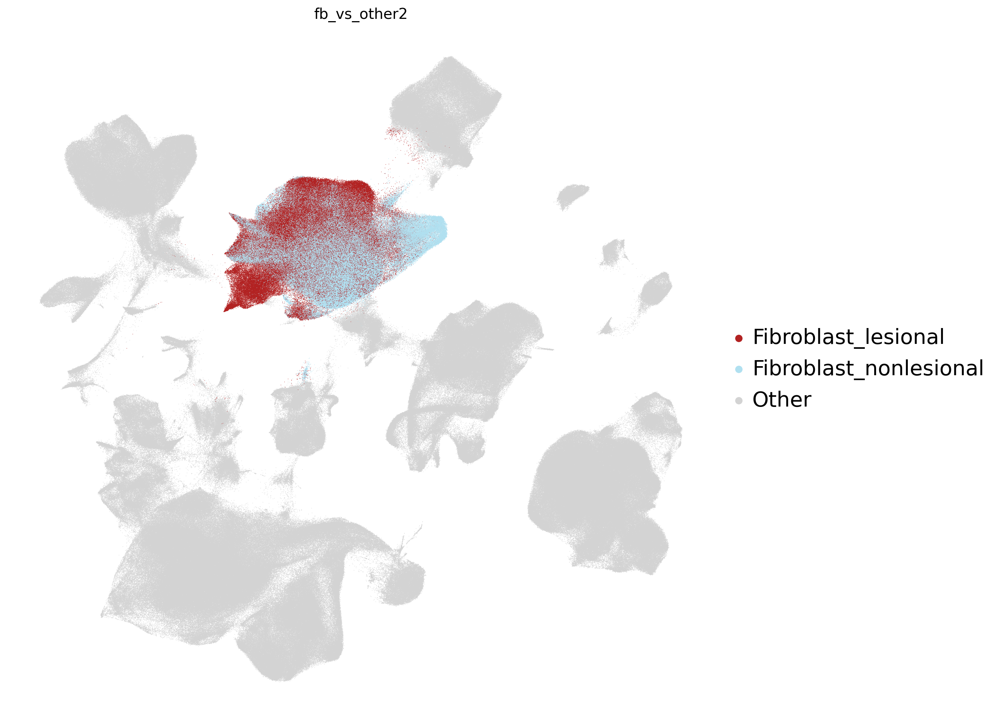

In [9]:
import numpy as np

# Create the new column based on the conditions
adata.obs["fb_vs_other2"] = np.where(
    (adata.obs["leiden_res0.2"] == "0") & (adata.obs["Site_status_binary"] == "Lesional"), "Fibroblast_lesional",
    np.where(
        (adata.obs["leiden_res0.2"] == "0") & (adata.obs["Site_status_binary"] == "Nonlesional"), "Fibroblast_nonlesional",
        "Other"
    )
)

# Define custom colors
custom_colors = {
    "Fibroblast_nonlesional": "#b0e0f0",  # Light blue
    "Fibroblast_lesional": "#B22222",  #FFB6C1",  # Light red
    "Other": "#D3D3D3"  # Light grey
}

# Ensure 'fb_vs_other2' is a categorical column
adata.obs["fb_vs_other2"] = adata.obs["fb_vs_other2"].astype("category")

# Map colors to the categories in 'fb_vs_other2'
adata.uns['fb_vs_other2_colors'] = [custom_colors[category] for category in adata.obs['fb_vs_other2'].cat.categories]

# Plotting
sc.settings.set_figure_params(dpi=100, facecolor="white", frameon=False, figsize=(12, 12))
sc.pl.umap(adata,  
           color="fb_vs_other2",
           s=1,
           legend_fontsize=20)


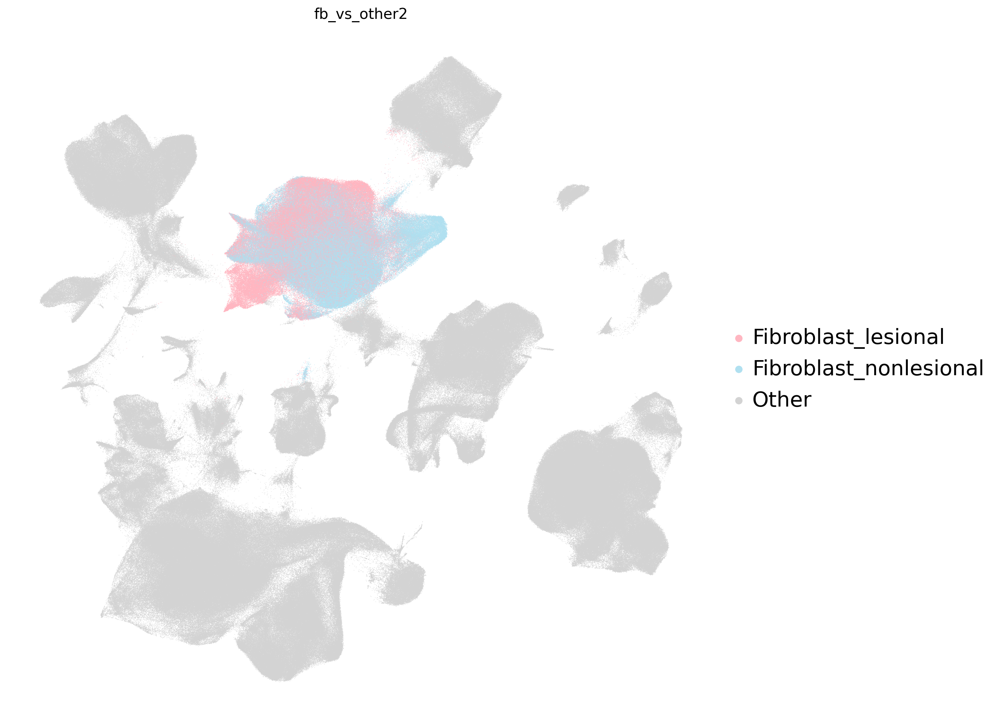

In [10]:
adata.obs["fb_vs_other2"] = np.where(
    (adata.obs["leiden_res0.2"] == "0") & (adata.obs["Site_status_binary"] == "Lesional"), "Fibroblast_lesional",
    np.where(
        (adata.obs["leiden_res0.2"] == "0") & (adata.obs["Site_status_binary"] == "Nonlesional"), "Fibroblast_nonlesional",
        "Other"
    )
)

# Define custom colors
custom_colors = {
    "Fibroblast_nonlesional": "#b0e0f0",  # Light blue
    "Fibroblast_lesional":  "#FFB6C1",   #FFB6C1",  # Light red
    "Other": "#D3D3D3"  # Light grey
}

# Ensure 'fb_vs_other2' is a categorical column
adata.obs["fb_vs_other2"] = adata.obs["fb_vs_other2"].astype("category")

# Map colors to the categories in 'fb_vs_other2'
adata.uns['fb_vs_other2_colors'] = [custom_colors[category] for category in adata.obs['fb_vs_other2'].cat.categories]

# Plotting
sc.settings.set_figure_params(dpi=100, facecolor="white", frameon=False, figsize=(12, 12))
sc.pl.umap(adata,  
           color="fb_vs_other2",
           s=1,
           legend_fontsize=20)


In [11]:
subset_cluster = ["10"]
sc.tl.leiden(adata, restrict_to=('leiden_res0.2',subset_cluster), resolution=0.1, random_state=1, key_added='core', neighbors_key='neighbor_30')


/tmp/ipykernel_2008250/1133612697.py:2: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, restrict_to=('leiden_res0.2',subset_cluster), resolution=0.1, random_state=1, key_added='core', neighbors_key='neighbor_30')


In [28]:
rename_dict = {"0": "Fibroblasts",
               "6": "Pericytes",
               "10,2": "Schwann",
               "10,6": "Schwann",
              "2": "Keratinocyte",
                   "8": "Keratinocyte",
                "5": "Keratinocyte",
                   "9": "Keratinocyte",
                  "15": "Keratinocyte",
                "16": "Muscle",
                "13": "Endothelium",
               "4": "Endothelium",
                 "1": "Lymphoid",
               "12": "Lymphoid",
                 "11": "Lymphoid",
               "14": "Mast cell",
               "7": "Junk"
              
              }

adata.obs["all"] = adata.obs["core"].map(rename_dict).fillna("Other")
               


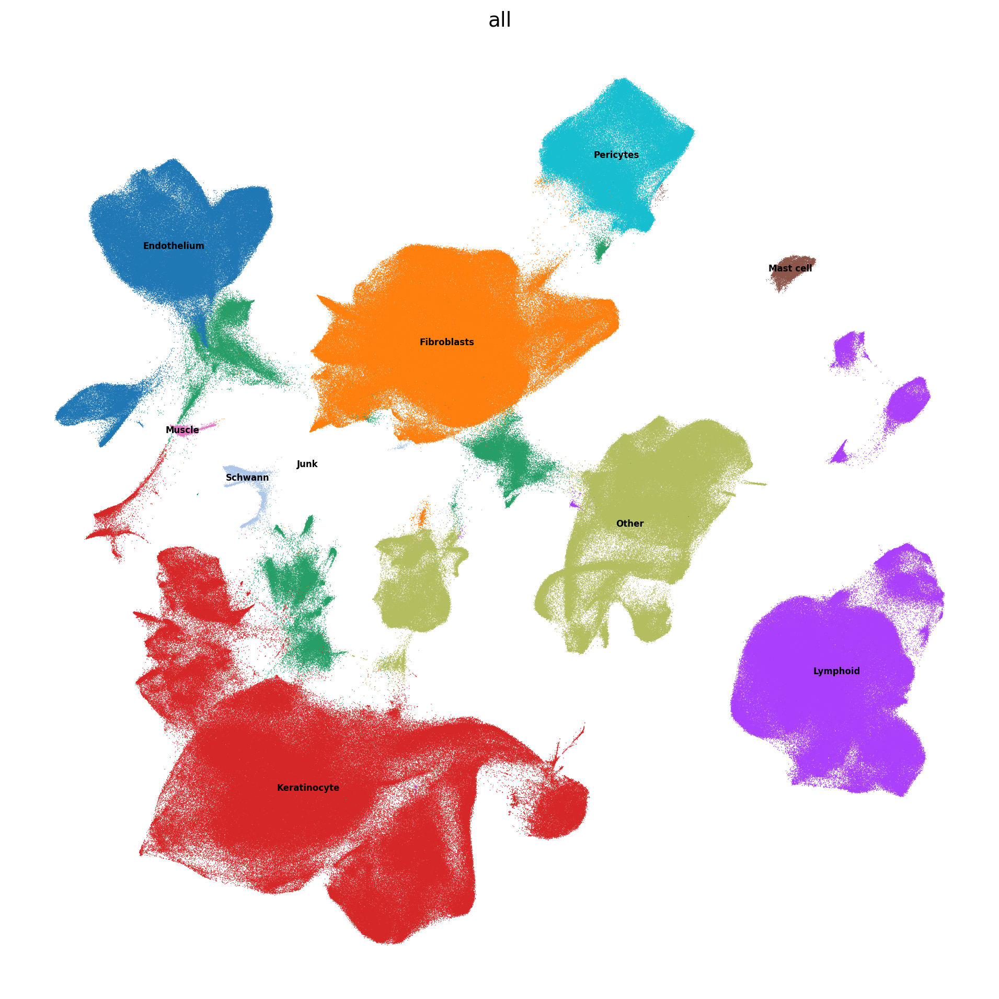

In [29]:
sc.pl.umap(adata,  
           color=["all"],
           s=1,
           legend_loc="on data",
           legend_fontsize=6)

In [30]:
adata = adata[adata.obs["all"]!="Junk"]

In [18]:
rename_dict = {"0": "Fibroblasts",
               "6": "Pericytes",
               "10,2": "Schwann",
               "10,6": "Schwann"}

adata.obs["fbs_pericytes_other"] = adata.obs["core"].map(rename_dict).fillna("Other")
               


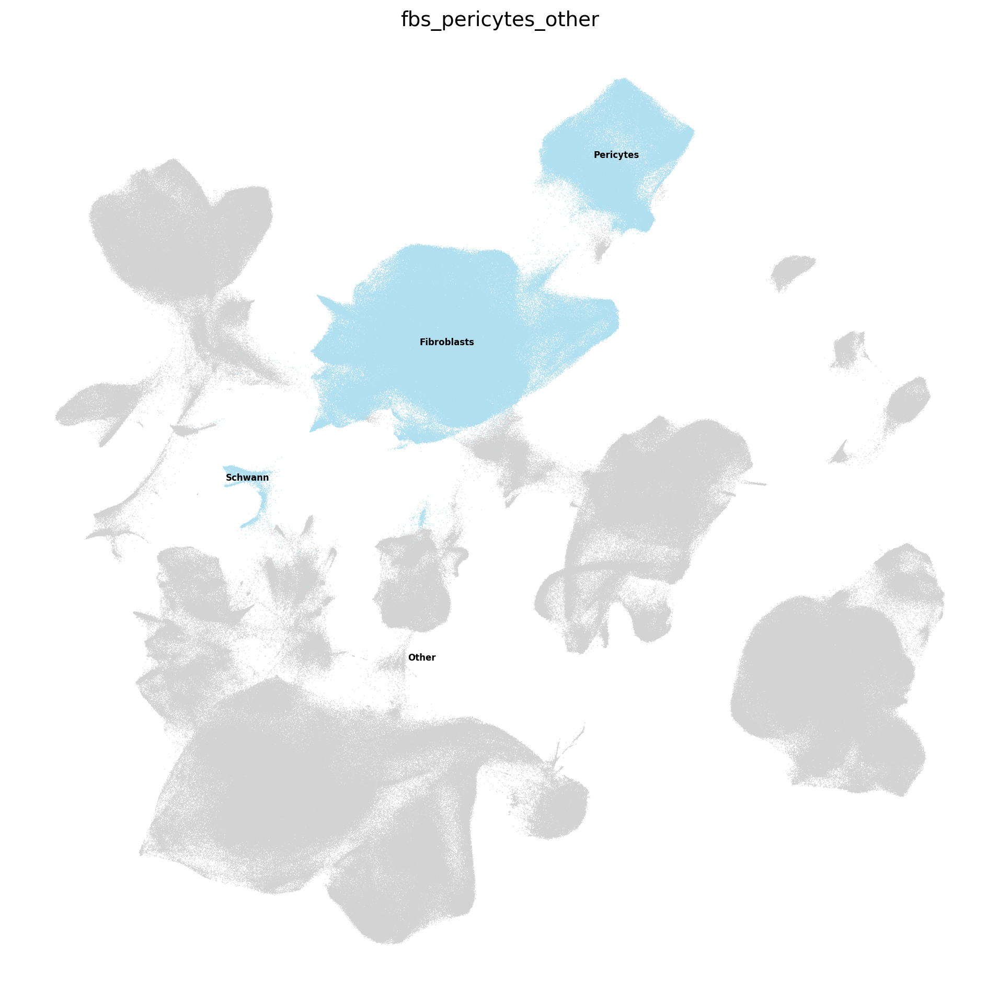

In [19]:
sc.pl.umap(adata,  
           color=["fbs_pericytes_other"],
           s=1,
           legend_loc="on data",
           legend_fontsize=6)

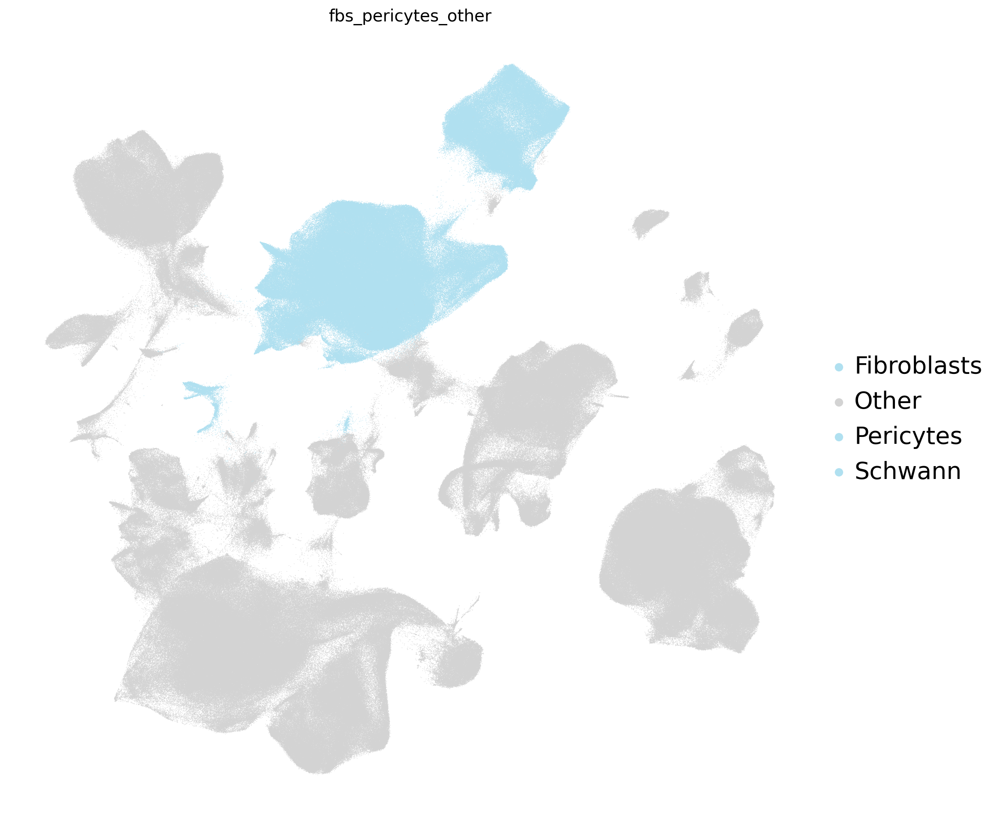

In [20]:
# Define custom colors
custom_colors = {
    "Pericytes": "#b0e0f0",  # Light blue
    "Fibroblasts":"#b0e0f0",   #FFB6C1",  # Light red
    "Schwann": "#b0e0f0",  
    "Other":    "#D3D3D3"  # Light grey
}

# Ensure 'fb_vs_other2' is a categorical column
adata.obs["fbs_pericytes_other"] = adata.obs["fbs_pericytes_other"].astype("category")

# Map colors to the categories in 'fb_vs_other2'
adata.uns['fbs_pericytes_other_colors'] = [custom_colors[category] for category in adata.obs['fbs_pericytes_other'].cat.categories]

# Plotting
sc.settings.set_figure_params(dpi=100, facecolor="white", frameon=False, figsize=(12, 12))
sc.pl.umap(adata,  
           color="fbs_pericytes_other",
           s=1,
           legend_fontsize=20)


# Save 

In [ ]:
adata_i = adata[adata.obs["leiden_res0.2"]=="0"]
adata_i = adata_i[adata_i.obs["Site_status_binary"]=="Nonlesional"]
donor_counts = adata_i.obs["DonorID"].value_counts()
donors_to_keep = donor_counts[donor_counts >= 100].index
adata_i = adata_i[adata_i.obs["DonorID"].isin(donors_to_keep)].copy()
adata_i.obs["DonorID"] = adata_i.obs["DonorID"].cat.remove_unused_categories()
adata_i.write('/nfs/team298/ls34/disease_atlas/data2/adata_fbsonly_nonlesional.h5ad')


In [ ]:
how can i set rows where adata.obs.dataset_id=="Dermalsheath_Ahlers" to have adata.obs["Sex"]="Female"adata_i = adata[adata.obs["fbs_pericytes_other"]!="Other"]
# donor_counts = adata_i.obs["DonorID"].value_counts()
# donors_to_keep = donor_counts[donor_counts >= 100].index
# adata_i = adata_i[adata_i.obs["DonorID"].isin(donors_to_keep)].copy()
# adata_i.obs["DonorID"] = adata_i.obs["DonorID"].cat.remove_unused_categories()
# adata_i.write('/nfs/team298/ls34/disease_atlas/data2/adata_fbspericyteschwann_only.h5ad')
adata_i = adata_i[adata_i.obs["Site_status_binary"]=="Nonlesional"]
donor_counts = adata_i.obs["DonorID"].value_counts()
donors_to_keep = donor_counts[donor_counts >= 100].index
adata_i = adata_i[adata_i.obs["DonorID"].isin(donors_to_keep)].copy()
adata_i.obs["DonorID"] = adata_i.obs["DonorID"].cat.remove_unused_categories()
adata_i.write('/nfs/team298/ls34/disease_atlas/data2/adata_fbspericyteschwann_nonlesional.h5ad')

In [ ]:
adata_i = adata[adata.obs["leiden_res0.2"]=="0"]
adata_i = adata_i[adata_i.obs["Site_status_binary"]=="Lesional"]
donor_counts = adata_i.obs["DonorID"].value_counts()
donors_to_keep = donor_counts[donor_counts >= 100].index
adata_i = adata_i[adata_i.obs["DonorID"].isin(donors_to_keep)].copy()
adata_i.obs["DonorID"] = adata_i.obs["DonorID"].cat.remove_unused_categories()
adata_i.write('/nfs/team298/ls34/disease_atlas/data2/adata_fbsonly_lesional.h5ad')


In [ ]:
adata_i = adata[adata.obs["fbs_pericytes_other"]!="Other"]
# donor_counts = adata_i.obs["DonorID"].value_counts()
# donors_to_keep = donor_counts[donor_counts >= 100].index
# adata_i = adata_i[adata_i.obs["DonorID"].isin(donors_to_keep)].copy()
# adata_i.obs["DonorID"] = adata_i.obs["DonorID"].cat.remove_unused_categories()
# adata_i.write('/nfs/team298/ls34/disease_atlas/data2/adata_fbspericyteschwann_only.h5ad')
adata_i = adata_i[adata_i.obs["Site_status_binary"]=="Lesional"]
donor_counts = adata_i.obs["DonorID"].value_counts()
donors_to_keep = donor_counts[donor_counts >= 100].index
adata_i = adata_i[adata_i.obs["DonorID"].isin(donors_to_keep)].copy()
adata_i.obs["DonorID"] = adata_i.obs["DonorID"].cat.remove_unused_categories()
adata_i.write('/nfs/team298/ls34/disease_atlas/data2/adata_fbspericyteschwann_lesional.h5ad')

# 